# Imports

In [1]:
from IPython.display import HTML
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
import numpy.polynomial.hermite as Herm
import math

# Test Animation

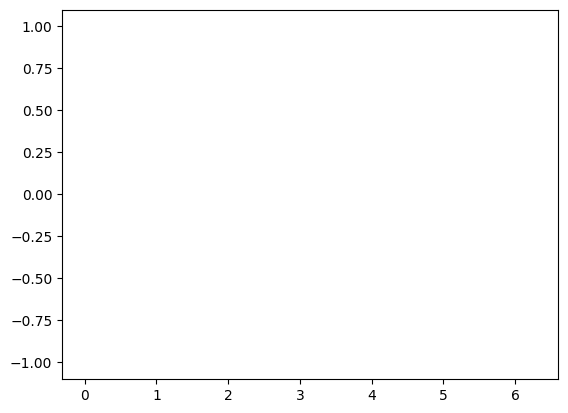

In [2]:
x = np.linspace(0, 2 * np.pi, 100)
y = np.sin(x)

fig, ax = plt.subplots()
line, = ax.plot(x, y)

def update(num, x, y, line):
    line.set_data(x[:num], y[:num])
    line.set_marker('o')
    return line,

ani = FuncAnimation(fig, update, frames=range(len(x)), fargs=[x, y, line])
# plt.show()

display(HTML(ani.to_jshtml()))

# test

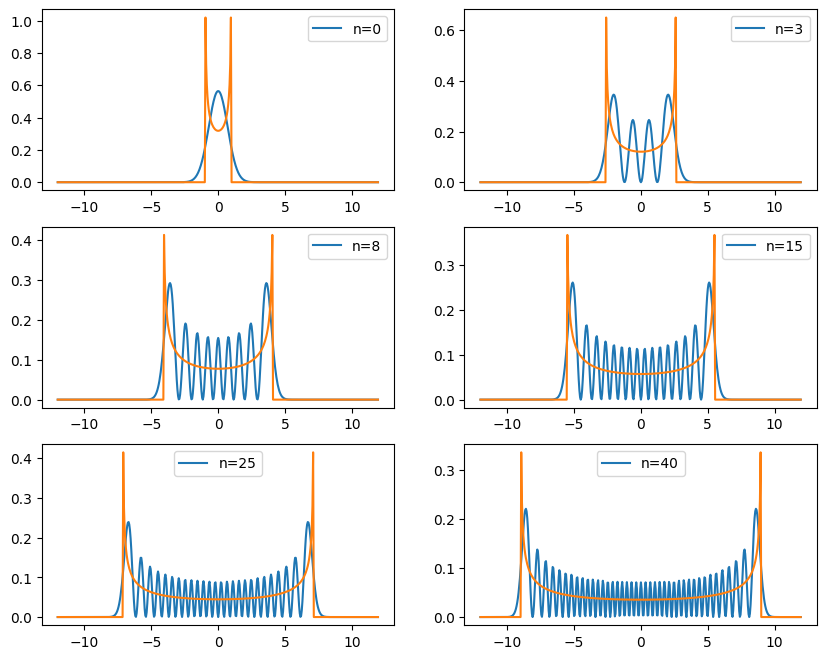

In [3]:
#Choose simple units
m=1.
w=1.
hbar=1.
#Discretized space
dx = 0.05
x_lim = 12
x = np.arange(-x_lim,x_lim,dx)

def hermite(x, n):
    xi = np.sqrt(m*w/hbar)*x
    herm_coeffs = np.zeros(n+1)
    herm_coeffs[n] = 1
    return Herm.hermval(xi, herm_coeffs)


def stationary_state(x,n):
    xi = np.sqrt(m*w/hbar)*x
    prefactor = 1./math.sqrt(2.**n * math.factorial(n)) * (m*w/(np.pi*hbar))**(0.25)
    psi = prefactor * np.exp(- xi**2 / 2) * hermite(x,n)
    return psi
  
def classical_P(x,n):
    E = hbar*w*(n+0.5)
    x_max = np.sqrt(2*E/(m*w**2))
    classical_prob = np.zeros(x.shape[0])
    x_inside = abs(x) < (x_max - 0.025)
    classical_prob[x_inside] = 1./np.pi/np.sqrt(x_max**2-x[x_inside]*x[x_inside])
    return classical_prob

plt.figure(figsize=(10, 8))
plt.subplot(3,2,1)
plt.plot(x, np.conjugate(stationary_state(x,0))*stationary_state(x,0), label="n=0")
plt.plot(x, classical_P(x,0))
plt.legend()
plt.subplot(3,2,2)
plt.plot(x, np.conjugate(stationary_state(x,3))*stationary_state(x,3), label="n=3")
plt.plot(x, classical_P(x,3))
plt.legend()
plt.subplot(3,2,3)
plt.plot(x, np.conjugate(stationary_state(x,8))*stationary_state(x,8), label="n=8")
plt.plot(x, classical_P(x,8))
plt.legend()
plt.subplot(3,2,4)
plt.plot(x, np.conjugate(stationary_state(x,15))*stationary_state(x,15), label="n=15")
plt.plot(x, classical_P(x,15))
plt.legend()
plt.subplot(3,2,5)
plt.plot(x, np.conjugate(stationary_state(x,25))*stationary_state(x,25), label="n=25")
plt.plot(x, classical_P(x,25))
plt.legend()
plt.subplot(3,2,6)
plt.plot(x, np.conjugate(stationary_state(x,40))*stationary_state(x,40), label="n=40")
plt.plot(x, classical_P(x,40))
plt.legend()
plt.show()

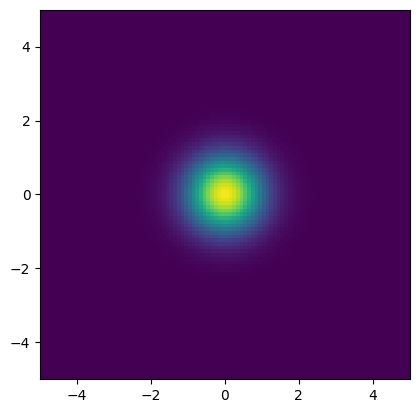

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Constants
mass = 1.0
omega = 1.0
hbar = 1.0
grid_size = 100
x_max = 5.0
y_max = 5.0
total_time = 10.0
dt = 0.01

# Initialize grid
x = np.linspace(-x_max, x_max, grid_size)
y = np.linspace(-y_max, y_max, grid_size)
X, Y = np.meshgrid(x, y)

# Initialize wavefunction (ground state)
psi = np.exp(-0.5 * (X**2 + Y**2))

# Create a figure
fig, ax = plt.subplots()

# Create an imshow plot for the wavefunction
line = ax.imshow(np.abs(psi)**2, extent=[-x_max, x_max, -y_max, y_max], cmap='viridis')

def update(frame, x, y, line):
    global psi
    psi_temp = psi.copy().astype('complex')
    # Time evolution in position space
    psi_temp *= np.exp(-0.5j * omega * dt)
    psi_temp = np.fft.ifft2(np.fft.fft2(psi_temp) * np.exp(-0.5j * (2 * np.pi * np.fft.fftfreq(grid_size, d=1.0/grid_size)**2) * dt))
    psi_temp *= np.exp(-0.5j * omega * dt)

    # Update the imshow plot
    line.set_data(np.abs(psi_temp)**2)

# Create an animation
ani = FuncAnimation(fig, update, frames=range(int(total_time / dt)), fargs=(x, y, line), repeat=False)

# Display the animation as HTML
HTML(ani.to_jshtml())


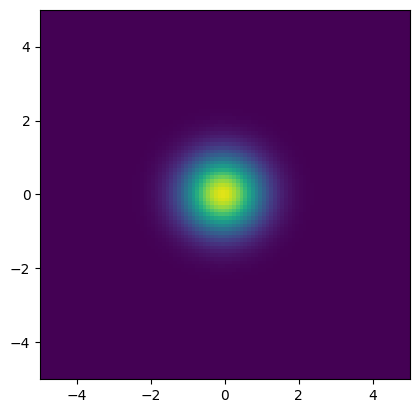

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Constants
mass = 1.0
omega = 1.0
hbar = 1.0
grid_size = 100
x_max = 5.0
y_max = 5.0
total_time = 10.0
dt = 0.01

# Initialize grid
x = np.linspace(-x_max, x_max, grid_size)
y = np.linspace(-y_max, y_max, grid_size)
X, Y = np.meshgrid(x, y)

# Initialize wavefunction (ground state)
psi = np.exp(-0.5 * (X**2 + Y**2)).astype('complex')

# Give the wavefunction an initial velocity along the x-axis
initial_velocity = 0.2
initial_momentum = mass * initial_velocity
phase_shift = -initial_momentum * X / hbar
psi *= np.exp(1j * phase_shift)

# Create a figure
fig, ax = plt.subplots()

# Create an imshow plot for the wavefunction
line = ax.imshow(np.abs(psi)**2, extent=[-x_max, x_max, -y_max, y_max], cmap='viridis')

def update(frame, x, y, line):
    global psi
    # Time evolution in position space
    psi *= np.exp(-0.5j * omega * dt)
    psi = np.fft.ifft2(np.fft.fft2(psi) * np.exp(-0.5j * (2 * np.pi * np.fft.fftfreq(grid_size, d=1.0/grid_size)**2) * dt))
    psi *= np.exp(-0.5j * omega * dt)

    # Update the imshow plot
    line.set_data(np.abs(psi)**2)

# Create an animation
ani = FuncAnimation(fig, update, frames=range(int(total_time / dt)), fargs=(x, y, line), repeat=False)

# Display the animation as HTML
HTML(ani.to_jshtml())


# Sympy to Numpy

In [10]:
import sympy as sp
import numpy as np

x = sp.symbols('x')

expr = sp.sin(x) + sp.cos(x)

expr
f = sp.lambdify(x, expr, 'numpy')
a = np.array([1, 2, 3, 4, 5])
f(a)

array([ 1.38177329,  0.49315059, -0.84887249, -1.41044612, -0.67526209])